# Detecção de outliers utilizando Mapas Auto-Organizáveis (SOM)

Fonte de dados: https://www.kaggle.com/mlg-ulb/creditcardfraud

In [28]:
!pip3 install minisom

In [29]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.cm as cm
import seaborn as sns
from matplotlib.pyplot import pie, axis, show
import locale

from minisom import MiniSom
from pylab import bone, pcolor, colorbar, plot, show

locale.setlocale(locale.LC_ALL, '')

locale._override_localeconv = {'mon_thousands_sep': '.'}

pd.options.display.float_format = "{:.2f}".format

In [30]:
df = pd.read_csv ("creditcard.csv")

In [31]:
df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.00,-1.36,-0.07,2.54,1.38,-0.34,0.46,0.24,0.10,0.36,...,-0.02,0.28,-0.11,0.07,0.13,-0.19,0.13,-0.02,149.62,0
1,0.00,1.19,0.27,0.17,0.45,0.06,-0.08,-0.08,0.09,-0.26,...,-0.23,-0.64,0.10,-0.34,0.17,0.13,-0.01,0.01,2.69,0
2,1.00,-1.36,-1.34,1.77,0.38,-0.50,1.80,0.79,0.25,-1.51,...,0.25,0.77,0.91,-0.69,-0.33,-0.14,-0.06,-0.06,378.66,0
3,1.00,-0.97,-0.19,1.79,-0.86,-0.01,1.25,0.24,0.38,-1.39,...,-0.11,0.01,-0.19,-1.18,0.65,-0.22,0.06,0.06,123.50,0
4,2.00,-1.16,0.88,1.55,0.40,-0.41,0.10,0.59,-0.27,0.82,...,-0.01,0.80,-0.14,0.14,-0.21,0.50,0.22,0.22,69.99,0


In [32]:
df

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.00,-1.36,-0.07,2.54,1.38,-0.34,0.46,0.24,0.10,0.36,...,-0.02,0.28,-0.11,0.07,0.13,-0.19,0.13,-0.02,149.62,0
1,0.00,1.19,0.27,0.17,0.45,0.06,-0.08,-0.08,0.09,-0.26,...,-0.23,-0.64,0.10,-0.34,0.17,0.13,-0.01,0.01,2.69,0
2,1.00,-1.36,-1.34,1.77,0.38,-0.50,1.80,0.79,0.25,-1.51,...,0.25,0.77,0.91,-0.69,-0.33,-0.14,-0.06,-0.06,378.66,0
3,1.00,-0.97,-0.19,1.79,-0.86,-0.01,1.25,0.24,0.38,-1.39,...,-0.11,0.01,-0.19,-1.18,0.65,-0.22,0.06,0.06,123.50,0
4,2.00,-1.16,0.88,1.55,0.40,-0.41,0.10,0.59,-0.27,0.82,...,-0.01,0.80,-0.14,0.14,-0.21,0.50,0.22,0.22,69.99,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284802,172786.00,-11.88,10.07,-9.83,-2.07,-5.36,-2.61,-4.92,7.31,1.91,...,0.21,0.11,1.01,-0.51,1.44,0.25,0.94,0.82,0.77,0
284803,172787.00,-0.73,-0.06,2.04,-0.74,0.87,1.06,0.02,0.29,0.58,...,0.21,0.92,0.01,-1.02,-0.61,-0.40,0.07,-0.05,24.79,0
284804,172788.00,1.92,-0.30,-3.25,-0.56,2.63,3.03,-0.30,0.71,0.43,...,0.23,0.58,-0.04,0.64,0.27,-0.09,0.00,-0.03,67.88,0
284805,172788.00,-0.24,0.53,0.70,0.69,-0.38,0.62,-0.69,0.68,0.39,...,0.27,0.80,-0.16,0.12,-0.57,0.55,0.11,0.10,10.00,0


In [33]:
X = df.drop(['Time','Amount', 'Class'], axis=1).astype('float') 
y = df['Class']

In [34]:
X.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28
0,-1.36,-0.07,2.54,1.38,-0.34,0.46,0.24,0.10,0.36,0.09,...,0.40,0.25,-0.02,0.28,-0.11,0.07,0.13,-0.19,0.13,-0.02
1,1.19,0.27,0.17,0.45,0.06,-0.08,-0.08,0.09,-0.26,-0.17,...,-0.15,-0.07,-0.23,-0.64,0.10,-0.34,0.17,0.13,-0.01,0.01
2,-1.36,-1.34,1.77,0.38,-0.50,1.80,0.79,0.25,-1.51,0.21,...,-2.26,0.52,0.25,0.77,0.91,-0.69,-0.33,-0.14,-0.06,-0.06
3,-0.97,-0.19,1.79,-0.86,-0.01,1.25,0.24,0.38,-1.39,-0.05,...,-1.23,-0.21,-0.11,0.01,-0.19,-1.18,0.65,-0.22,0.06,0.06
4,-1.16,0.88,1.55,0.40,-0.41,0.10,0.59,-0.27,0.82,0.75,...,0.80,0.41,-0.01,0.80,-0.14,0.14,-0.21,0.50,0.22,0.22


In [35]:
X = X.values

n_neurons = 10
m_neurons = 10
som = MiniSom(n_neurons, m_neurons, input_len = 28, sigma = 1.5, learning_rate = 0.3, random_seed=1)
som.random_weights_init(X)
som.train(X, 100, verbose=True)

 [ 100 / 100 ] 100% - 0:00:00 left 
 quantization error: 4.052051858453518


In [36]:
# Retorna um dataframe contendo as instâncias de uma determinada celula
def getWinnerInstances(n):

    df_winner_list = []

    for i, x in enumerate(X): 

        w = som.winner(x)

        if w == n:
            df_winner_list.append(df.iloc[i])
        
    return pd.DataFrame(df_winner_list)

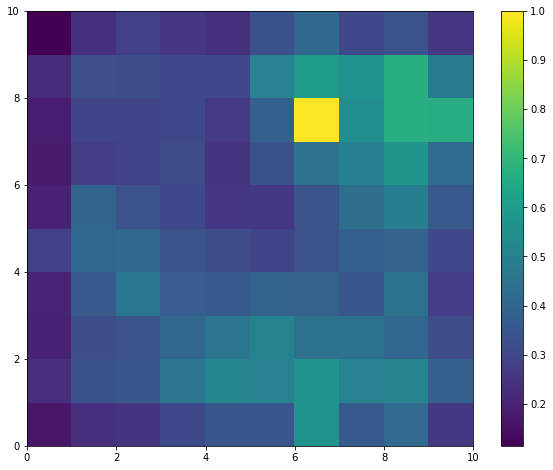

In [37]:
plt.figure(figsize=(10, 8))

plt.pcolor(som.distance_map().T)  
plt.colorbar()

markers = ['o', 's', 'D']
colors = ['C3', 'C1', 'C2']

plt.show()

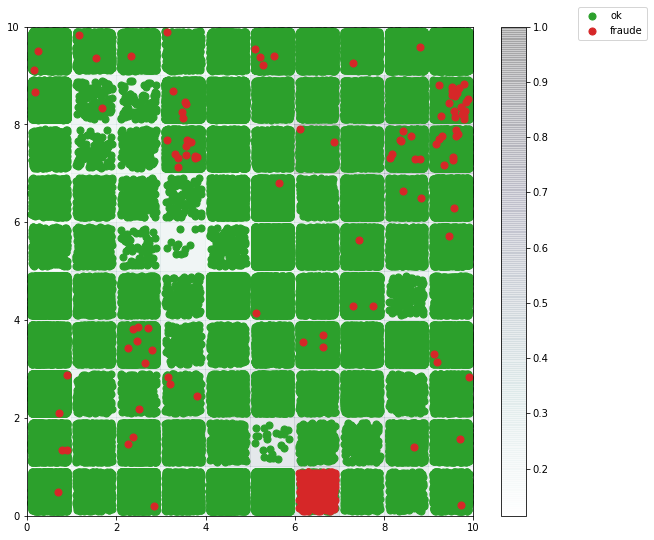

In [38]:
label_names = {0:'ok', 1:'fraude'}

w_x, w_y = zip(*[som.winner(d) for d in X])
w_x = np.array(w_x)
w_y = np.array(w_y)

plt.figure(figsize=(10, 9))
plt.pcolor(som.distance_map().T, cmap='bone_r', alpha=.2)
plt.colorbar()

for c in np.unique(y):
    idx_target = y==c
    plt.scatter(w_x[idx_target]+.5+(np.random.rand(np.sum(idx_target))-.5)*.8,
                w_y[idx_target]+.5+(np.random.rand(np.sum(idx_target))-.5)*.8, 
                s=50, c=colors[c-1], label=label_names[c])
plt.legend(loc='upper right', bbox_to_anchor=(1.4, 1.05))

In [39]:
instances = getWinnerInstances((6,7))

print(str(len(instances[instances['Class'] == 0])) + " casos ok e " + str(len(instances[instances['Class'] == 1])) + " casos com fraude.")

2226 casos ok e 2 casos com fraude.


In [40]:
instances[instances['Class'] == 1]

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
83297,59777.00,-8.26,-4.81,-5.37,1.20,-3.35,-1.33,-1.97,1.30,-1.67,...,0.44,-0.08,-3.09,-0.39,-0.29,-0.34,0.04,-1.01,319.20,1.00
191074,129095.00,-1.84,-1.65,-3.38,0.47,0.07,-0.45,3.79,-1.35,0.10,...,0.01,1.79,-0.15,-0.58,-0.96,-0.33,0.72,0.37,720.80,1.00


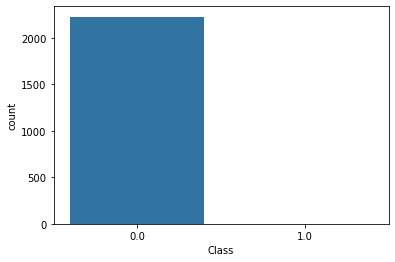

In [41]:
sns.countplot(x='Class', data=instances)